Now that I have the map generation working (as seen in MapGeneration2), time to get the first version of the migration system working. The goal here is to instantiate a batch of people/families/agents with different colour affinities and have them move around to find the best spot for them. Nothing beyond that for this version, no evolution or breeding or anything like that.


Very basic version of the simple system working in 1.1. Time to add some functionality: bigger map, better balance, ability to have multiple set colour affinities (effectively multiple populations).

Next step: add exluded volume around each person. Not sure if it should be black and white or done as a decrease to the probability of moving near another person, have a think about it.

Think I should refactor the location functions to sort the values. That'll make finding the nearby people much more efficient rather than having to check the whole list.

For the excluded volume for now: In each update find the 




Update position and creating the animation are all working but need plenty of tuning to get working well. Play around with factors to balance it all. Have a look at proposing multiple locations and metropolis checking each one or the best of them, have a look at how the affinity is judged (simplistic atm), tune the metropolis settings (steepness and range of the threshold)

In [1]:
from perlin_noise import PerlinNoise as perlin
import numpy as np
from matplotlib import pyplot as plt
import random
import matplotlib.animation

## Map generation

In [12]:
class WorldMap:
    
    zoomFactorr = 2       # How much the sample region is zoomed into the perlin pattern
    zoomFactorg = 4       # Bigger number = more noise (I think, might be the opposite)
    zoomFactorb = 3
    
    rInfluence = 0.7     # Strength of the offsets each channel applies to the base colour
    gInfluence = 0.7
    bInfluence = 0.7
    
    def __init__(self, mapWidth, mapHeight, baseColour):
        # Map settings
        self.mapWidth = mapWidth
        self.mapHeight = mapHeight
        self.baseColour = baseColour
    
        
        
        # Generate the perlin noise for each colour with a random seed
        noiser = perlin(octaves=10, seed=random.randint(1,75))
        noiseg = perlin(octaves=10, seed=random.randint(1,75))
        noiseb = perlin(octaves=10, seed=random.randint(1,75))
        
        
        # Range of the channel = (-1,1)*colourInfluence
        rChannel = [[(noiser([i/(mapWidth*self.zoomFactorr), j/(mapHeight*self.zoomFactorr)]))*self.rInfluence for j in range(mapWidth)] for i in range(mapHeight)]
        gChannel = [[(noiseg([i/(mapWidth*self.zoomFactorg), j/(mapHeight*self.zoomFactorg)]))*self.gInfluence for j in range(mapWidth)] for i in range(mapHeight)]
        bChannel = [[(noiseb([i/(mapWidth*self.zoomFactorb), j/(mapHeight*self.zoomFactorb)]))*self.bInfluence for j in range(mapWidth)] for i in range(mapHeight)]
        
        
        # 2d array of rgb colour values, instatiated with all values as rgb = (baseColour, baseColour, baseColour)
        self.world = [[np.array([baseColour,baseColour,baseColour]) for j in range(mapWidth)] for i in range(mapHeight)]
        
        # For each location, offset the baseColour rgb value by the perlin noise for that colour
        for i in range(mapWidth):
            for j in range(mapHeight):
                self.world[j][i] = np.array([baseColour + rChannel[j][i], baseColour + gChannel[j][i], baseColour + bChannel[j][i]])
        
    def draw(self):
        plt.imshow(self.world, cmap='gray')
        
    
    def colourAt(self, x, y):
        return self.world[y][x]

[0.42740626 0.32005038 0.40992384]


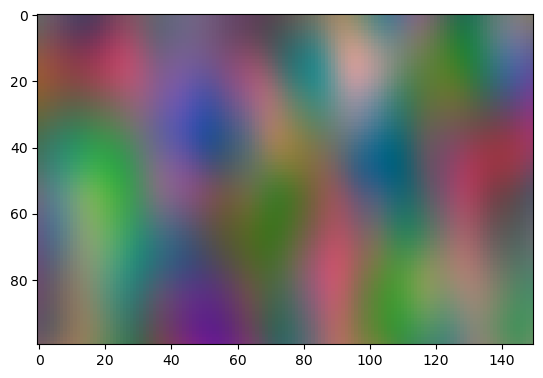

In [37]:
world = WorldMap(150,100,0.4)
world.draw()
print(world.colourAt(120,50))

In [30]:
def sigmoidFunction(x, steepness):
    return 1/(1+np.exp(-steepness*x))

In [38]:
class Person:
    metropolisSteepness = 50
    searchRange = 15
    
    def __init__(self, mapWidth, mapHeight, baseColour):
        self.x = random.randint(1,mapWidth-1)
        self.y = random.randint(1,mapHeight-1)
        
        self.colourAffinity = np.array([random.random(), random.random(), random.random()])
        # Very good chance I might want to change this to an offset from a baseColour
        
    def move(self, world):
        # Loads of options for picking a new location, go with this for now
        # pseudocode: find magnitude of difference between current location and colour affinity
        # propose a new point within a certain range (hardcoded for now)
        # Metropolis check that new one vs the current one
        # set location to new one if passed, keep current location if failed
        
        proposedx = self.x + random.randint(-self.searchRange,self.searchRange)
        proposedy = self.y + random.randint(-self.searchRange,self.searchRange)
        
        # Make sure the proposed location is still in the map range
        proposedx = min(max(1,proposedx),world.mapWidth-1)
        proposedy = min(max(1,proposedy),world.mapHeight-1)
        
        currentDifference = world.colourAt(self.x,self.y) - self.colourAffinity
        proposedDifference = world.colourAt(proposedx,proposedy) - self.colourAffinity

        #currentDifference = worldMap[self.y][self.x] - self.colourAffinity
        #proposedDifference = worldMap[proposedy][proposedx] - self.colourAffinity
        
        currentDifferenceMagnitude = np.sum(currentDifference**2)
        proposedDifferenceMagnitude = np.sum(proposedDifference**2)

        # Metropolis check with hardcoded thresholds and stuff
        threshold = random.random()
        
        if sigmoidFunction(currentDifferenceMagnitude - proposedDifferenceMagnitude, self.metropolisSteepness) > threshold:
            self.x = proposedx
            self.y = proposedy        
        
            
        #return proposedDifferenceMagnitude - currentDifferenceMagnitude

        
        
class PersonList:
    
    def __init__(self, numPeople, mapWidth, mapHeight, baseColour):
        self.numPeople = numPeople
        self.people = [Person(mapWidth, mapHeight, baseColour) for i in range(numPeople)]
        #self.affinityDiffs = np.zeros(numPeople)
        
        
    # Loop through the person list and set the affinity of each one to be from a set list
    def setAffinities(self, affinityList):
        for i in range(self.numPeople):
            
            self.people[i].colourAffinity = affinityList[i % len(affinityList)]
            
    # Propose a list of colours to use with setAffinities above
    def proposeColours(self, numColours):
        return [np.array([random.random(), random.random(), random.random()]) for i in range(numColours)]
        
    
    
    # Convenience functions to return the properties of all people in the list
    def xLocations(self):
        xLocs = [0 for i in range(self.numPeople)]
        for i in range(self.numPeople):
            xLocs[i] = self.people[i].x
        return xLocs
    
    def yLocations(self):
        yLocs = [0 for i in range(self.numPeople)]
        for i in range(self.numPeople):
            yLocs[i] = self.people[i].y
        return yLocs
    
    def colourAffinities(self):
        affinities = [[0,0,0] for i in range(self.numPeople)]
        for i in range(self.numPeople):
            affinities[i] = self.people[i].colourAffinity
        return affinities
    
    def draw(self):
        plt.scatter(self.xLocations(), self.yLocations(), c=(self.colourAffinities()))
        
    def update(self,world):
        xLocs 
        for i in range(self.numPeople):
            self.people[i].move(world)


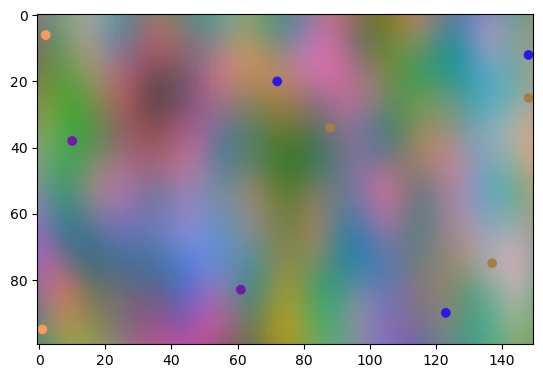

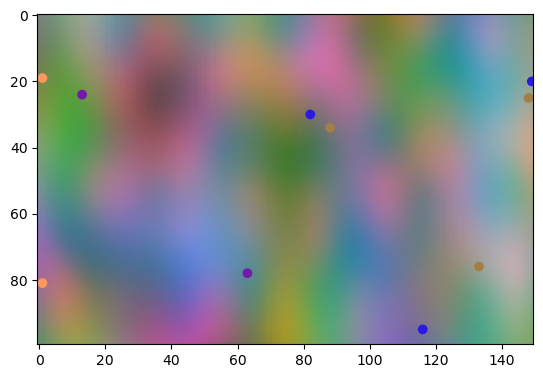

In [39]:
# Test the classes and drawing the people
world = WorldMap(150,100,0.5)

testList = PersonList(10, world.mapWidth, world.mapHeight, world.baseColour)
testList.setAffinities(testList.proposeColours(4))

world.draw()
testList.draw()
plt.show()

world.draw()
testList.update(world)
testList.draw()
plt.show()

In [42]:
testList = PersonList(10, world.mapWidth, world.mapHeight, world.baseColour)
testList.setAffinities(testList.proposeColours(4))

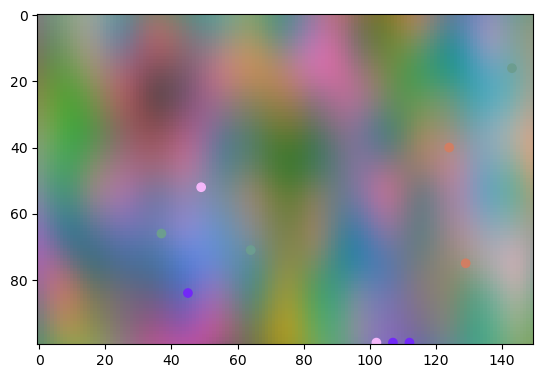

In [83]:
#plt.cla()
world.draw()
testList.update(world)
testList.draw()

In [49]:
# Animation testing

testList = PersonList(10, mapWidth, mapHeight, baseValue)
testList.setAffinities(testList.proposeColours(4))


plt.rcParams["animation.html"] = "jshtml"
#plt.rcParams['figure.dpi'] = 150  
plt.ioff()
fig, ax = plt.subplots()

def animate(t):
    plt.cla()
    plt.imshow(worldMap, cmap='gray')
    testList.update()
    testList.draw()
    #plt.show()

matplotlib.animation.FuncAnimation(fig, animate, frames=200, interval=60)

Animation size has reached 21131063 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [164]:
# Animation testing

plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 150  
plt.ioff()
fig, ax = plt.subplots()

x = np.linspace(0,10,100)
def animate(t):
    plt.cla()
    plt.plot(x,np.sin(x+t))
    plt.xlim(0,10)

matplotlib.animation.FuncAnimation(fig, animate, frames=20)

In [178]:
# Test out the sigmoid function
plt.figure(dpi=200)

squishFactor = 50
plotRange = 0.3

x = np.arange(-plotRange,plotRange,0.01)

plt.plot(x, 1/(1+np.exp(-squishFactor*x)))
plt.scatter(testList.affinityDiffs, 1/(1+np.exp(-squishFactor*testList.affinityDiffs)))

plt.grid()

AttributeError: 'PersonList' object has no attribute 'affinityDiffs'

In [123]:
worldMap[99][139]

array([0.32307083, 0.78490276, 0.52384041])

In [25]:
print(4 % 5)

4
